In [ ]:
!pip install google-generativeai

In [ ]:
#we will be exploring google's python wrapper around their ai API
import os
import google.generativeai as genai

#generate your own key on https://aistudio.google.com/apikey
gemini_api_key = 

genai.configure(api_key=gemini_api_key)
multimodal_model = genai.GenerativeModel("gemini-1.5-flash-002")


In [4]:
#we can then query this model to generate text and images

model_response = multimodal_model.generate_content("hi, how was your day?")


In [ ]:
#the output is given to us in a dictionary format, like most other APIs we've explored
model_response 

response:
GenerateContentResponse(
    done=True,
    iterator=None,
    result=protos.GenerateContentResponse({
      "candidates": [
        {
          "content": {
            "parts": [
              {
                "text": "As a large language model, I don't experience days in the same way humans do.  I don't have feelings or personal experiences. However, I've processed and responded to a large number of requests today, which is how I measure my activity.  It's been a busy one!\n"
              }
            ],
            "role": "model"
          },
          "finish_reason": "STOP",
          "avg_logprobs": -0.11358562856912613
        }
      ],
      "usage_metadata": {
        "prompt_token_count": 8,
        "candidates_token_count": 64,
        "total_token_count": 72
      }
    }),
)

In [8]:
model_response.text

"As a large language model, I don't experience days in the same way humans do.  I don't have feelings or personal experiences. However, I've processed and responded to a large number of requests today, which is how I measure my activity.  It's been a busy one!\n"

In [11]:
#we can ask the model to complete tasks for us, like summarizing text
model_response = multimodal_model.generate_content("summarize this text: Digital humanities research has focused primarily on the analysis of texts. This emphasis stems from the availability of technology to study digitized text. Optical character recognition allows researchers to use keywords to search and analyze digitized texts. However, archives of digitized sources also contain large numbers of images. This article shows how convolutional neural networks (CNNs) can be used to categorize and analyze digitized historical visual sources. We present three different approaches to using CNNs for gaining a deeper understanding of visual trends in an archive of digitized Dutch newspapers. These include detecting medium-specific features (separating photographs from illustrations), querying images based on abstract visual aspects (clustering visually similar advertisements), and training a neural network based on visual categories developed by domain experts. We argue that CNNs allow researchers to explore the visual side of the digital turn. They allow archivists and researchers to classify and spot trends in large collections of digitized visual sources in radically new ways.")


In [14]:
#print the text wraparound

print(model_response.text)


This article advocates for using convolutional neural networks (CNNs) to analyze the vast quantities of digitized images within historical archives, a field currently dominated by text analysis.  The authors demonstrate three applications of CNNs to a collection of digitized Dutch newspapers: distinguishing image types (photos vs. illustrations), identifying visually similar images (e.g., advertisements), and categorizing images based on expert-defined visual categories.  They conclude that CNNs offer powerful new tools for researchers to explore and understand visual trends in large digital archives.



In [ ]:
#we can slightly modify the prompt to impact behavior
model_response = multimodal_model.generate_content("briefly summarize this text for an intro audience with line breaks: Digital humanities research has focused primarily on the analysis of texts. This emphasis stems from the availability of technology to study digitized text. Optical character recognition allows researchers to use keywords to search and analyze digitized texts. However, archives of digitized sources also contain large numbers of images. This article shows how convolutional neural networks (CNNs) can be used to categorize and analyze digitized historical visual sources. We present three different approaches to using CNNs for gaining a deeper understanding of visual trends in an archive of digitized Dutch newspapers. These include detecting medium-specific features (separating photographs from illustrations), querying images based on abstract visual aspects (clustering visually similar advertisements), and training a neural network based on visual categories developed by domain experts. We argue that CNNs allow researchers to explore the visual side of the digital turn. They allow archivists and researchers to classify and spot trends in large collections of digitized visual sources in radically new ways.")


In [16]:
print(model_response.text)


Digital humanities usually focuses on text analysis.

But archives also hold many images.

This article shows how computer vision (using "CNNs") can analyze these images.

Three examples using Dutch newspaper images are given:  separating photos from drawings, finding similar images, and using expert knowledge to categorize images.

This expands digital humanities to include visual analysis of large image archives.



In [27]:
#we can also ask it to do topic extraction, classification, or any other NLP task

model_response = multimodal_model.generate_content("is the following text more likely to be academic, social media, or news? Answer in one word: Digital humanities research has focused primarily on the analysis of texts. This emphasis stems from the availability of technology to study digitized text. Optical character recognition allows researchers to use keywords to search and analyze digitized texts. However, archives of digitized sources also contain large numbers of images. This article shows how convolutional neural networks (CNNs) can be used to categorize and analyze digitized historical visual sources. We present three different approaches to using CNNs for gaining a deeper understanding of visual trends in an archive of digitized Dutch newspapers. These include detecting medium-specific features (separating photographs from illustrations), querying images based on abstract visual aspects (clustering visually similar advertisements), and training a neural network based on visual categories developed by domain experts. We argue that CNNs allow researchers to explore the visual side of the digital turn. They allow archivists and researchers to classify and spot trends in large collections of digitized visual sources in radically new ways.")

In [28]:
print(model_response.text)

Academic



In [35]:
import pandas as pd
misinfo=pd.read_csv("misinfo.csv")

In [ ]:
misinfo["text"][0][

'Donald Trump just couldn t wish all Americans a Happy New Year and leave it at that. Instead, he had to give a shout out to his enemies, haters and  the very dishonest fake news media.  The former reality show star had just one job to do and he couldn t do it. As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year,  President Angry Pants tweeted.  2018 will be a great year for America! As our Country rapidly grows stronger and smarter, I want to wish all of my friends, supporters, enemies, haters, and even the very dishonest Fake News Media, a Happy and Healthy New Year. 2018 will be a great year for America!  Donald J. Trump (@realDonaldTrump) December 31, 2017Trump s tweet went down about as welll as you d expect.What kind of president sends a New Year s greeting like this despicable, petty, infantile gibberish? Only Trump! His lack of decency won t ev

In [ ]:
#we can use this to automate a workflow, like classifying a dataset
scores=[]
for m in misinfo['text']:
    #keep first hundred characters
    m=m[:100]
    model_response = multimodal_model.generate_content("How likely is the following text to be misinformation from 1-10? Answer in number only:"+ m)
    scores.append( model_response.text)

In [43]:
#we can use this to automate a workflow, like classifying a dataset
scores=[]
for m in misinfo['text']:
    #keep first hundred characters
    m=m[:100]
    model_response = multimodal_model.generate_content("As an average low information voter? How likely is the following text to be misinformation from 1-10? Answer in number only:"+ m)
    scores.append( model_response.text)

In [42]:
scores

['7\n',
 '7\n',
 '7\n',
 '7\n',
 '7\n',
 '7\n',
 '7\n',
 '8\n',
 '7\n',
 '8\n',
 '8\n',
 '7\n',
 '7\n',
 '7\n',
 '8\n',
 '8\n',
 '8\n',
 '7\n',
 '7\n',
 '7\n']

In [44]:
scores

['7\n',
 '7\n',
 '7\n',
 '8\n',
 '7\n',
 '7\n',
 '7\n',
 '8\n',
 '7\n',
 '8\n',
 '8\n',
 '7\n',
 '7\n',
 '7\n',
 '8\n',
 '8\n',
 '8\n',
 '7\n',
 '7\n',
 '7\n']

In [52]:
#read image into pillow file

from PIL import Image

img = Image.open("bentham.jpg")

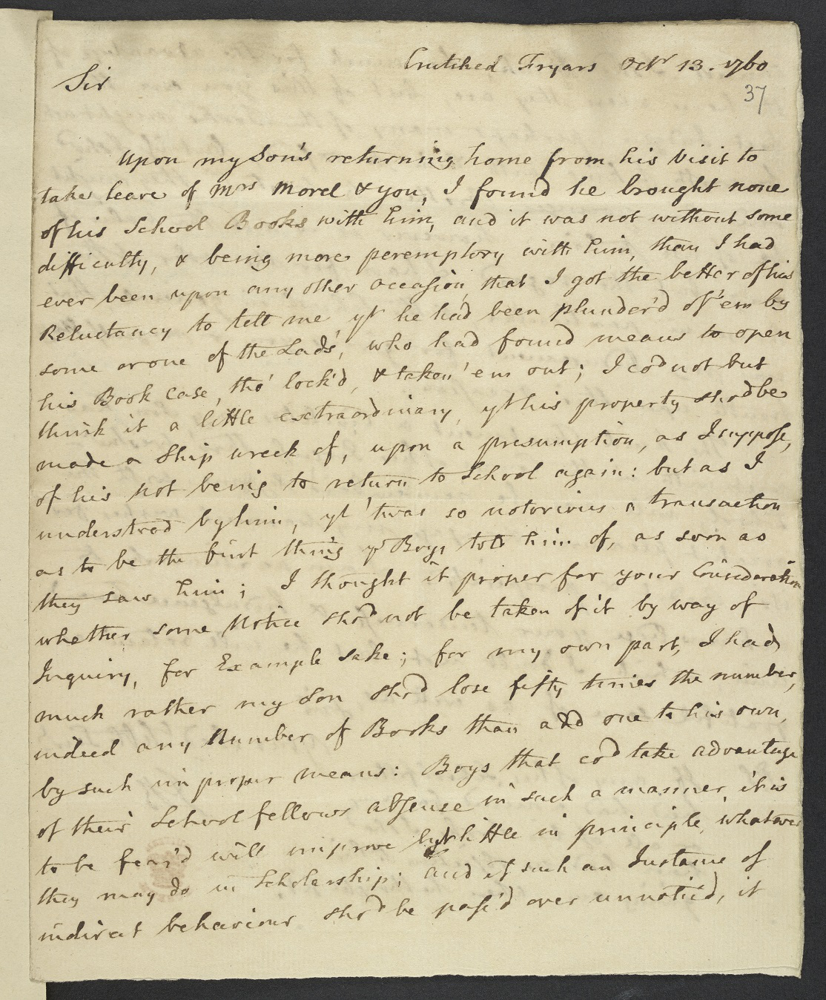

In [53]:
img

In [20]:
model_response = multimodal_model.generate_content(["transcribe the following letter: ", img])


In [22]:
print(model_response.text)

Sir,

Crutched Fryars Oct 13. 1760

Upon my son’s returning home from his visit to take leave of most moral of you, I found he brought none of his school books with him, and it was not without some difficulty & being more peremptory with him than I had ever been upon any other occasion that I got the better of his reluctance to tell me that he had been plundered of them by some one of the lads, who had found means to open his book case & lock’d, & taken them out; I could not but think it a little extraordinary, this property should be made a ship-wreck of, upon a presumption, as I supposed, of his not being to return to school again; but as I understood by him it was so notorious a transaction as to be the first thing they saw him, I thought it proper for your consideration whether some notice should be taken of it by way of enquiry, for example sake; for my own part, I had much rather my son should lose fifty times the number and one his own, indeed any number of books than that he sh

In [55]:
img = Image.open("harrypotter.webp")

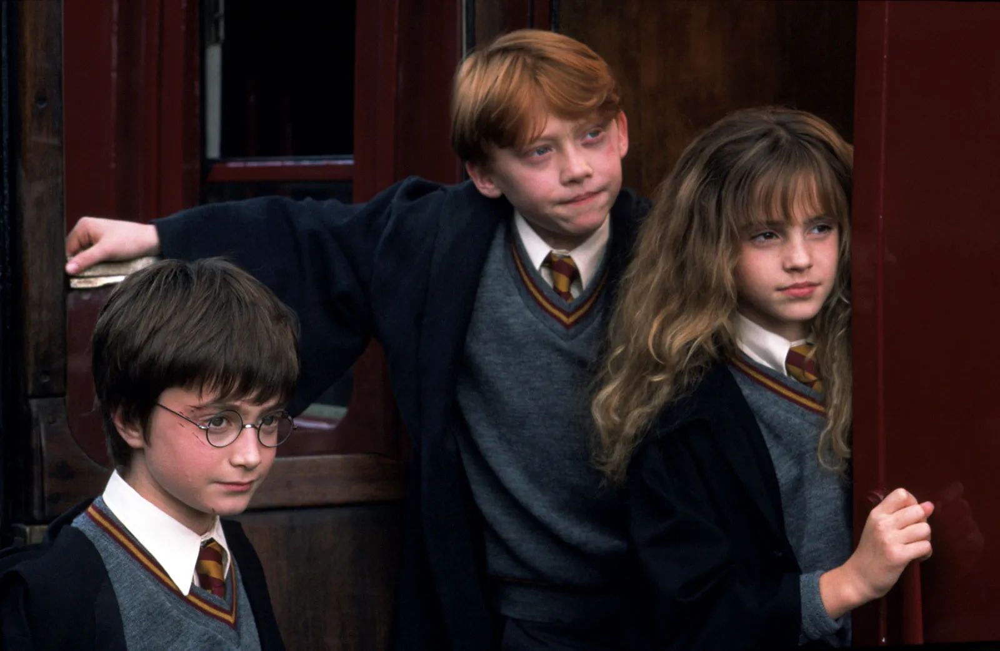

In [56]:
img

In [50]:
model_response = multimodal_model.generate_content(["how many male and female actors are in this image? return as list of two numbers: ", img])


In [57]:
model_response.text

'[2, 1]'

In [58]:
img = Image.open("twilight.webp")
model_response = multimodal_model.generate_content(["how many male and female actors are in this image? return as list of two numbers: ", img])


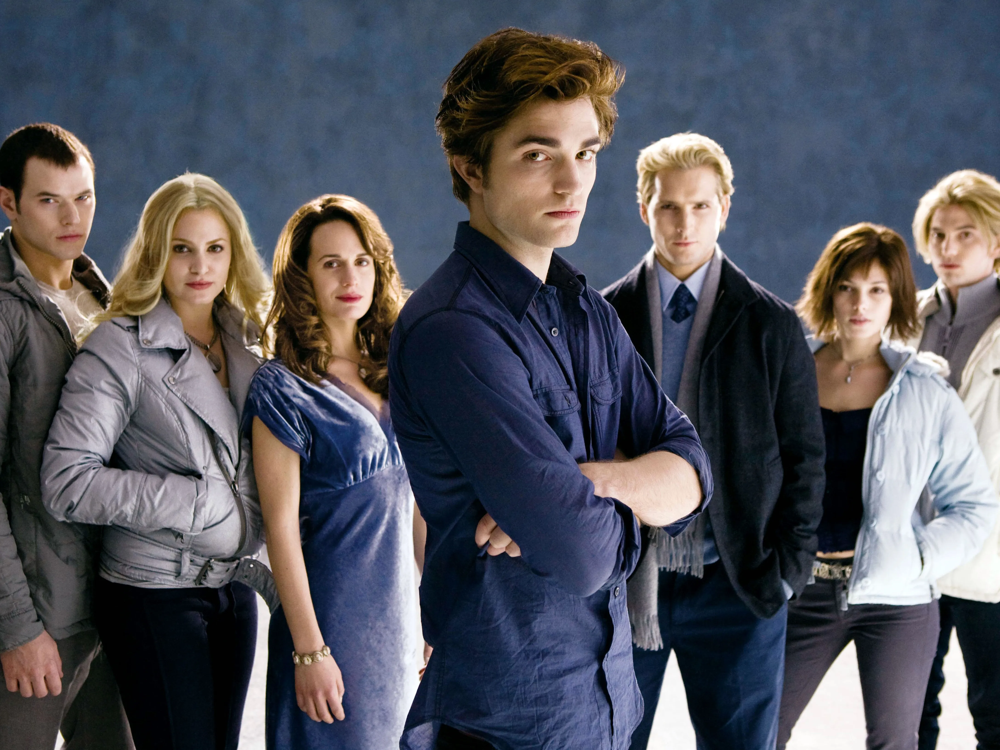

In [60]:
img

In [59]:
model_response.text

'[4, 4]'